In [3]:
# https://www.kaggle.com/aruchomu/yolo-v3-object-detection-in-tensorflow

In [4]:
import tensorflow as tf
import numpy as np
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display
from seaborn import color_palette
import cv2

In [5]:
_BATCH_NORM_DECAY = 0.9
_BATCH_NORM_EPSILON = 1e-05
_LEAKY_RELU = 0.1
_ANCHORS = [(10, 13), (16, 30), (33, 23),
            (30, 61), (62, 45), (59, 119),
            (116, 90), (156, 198), (373, 326)]
_MODEL_SIZE = (416, 416)

In [6]:
def batch_norm(inputs, training, data_format):
    """Performs a batch normalization using a standard set of parameters."""
    return tf.layers.batch_normalization(
        inputs=inputs, axis=1 if data_format == 'channels_first' else 3,
        momentum=_BATCH_NORM_DECAY, epsilon=_BATCH_NORM_EPSILON,
        scale=True, training=training)


def fixed_padding(inputs, kernel_size, data_format):
    """ResNet implementation of fixed padding.

    Pads the input along the spatial dimensions independently of input size.

    Args:
        inputs: Tensor input to be padded.
        kernel_size: The kernel to be used in the conv2d or max_pool2d.
        data_format: The input format.
    Returns:
        A tensor with the same format as the input.
    """
    pad_total = kernel_size - 1
    pad_beg = pad_total // 2
    pad_end = pad_total - pad_beg

    if data_format == 'channels_first':
        padded_inputs = tf.pad(inputs, [[0, 0], [0, 0],
                                        [pad_beg, pad_end],
                                        [pad_beg, pad_end]])
    else:
        padded_inputs = tf.pad(inputs, [[0, 0], [pad_beg, pad_end],
                                        [pad_beg, pad_end], [0, 0]])
    return padded_inputs


def conv2d_fixed_padding(inputs, filters, kernel_size, data_format, strides=1):
    """Strided 2-D convolution with explicit padding."""
    if strides > 1:
        inputs = fixed_padding(inputs, kernel_size, data_format)

    return tf.layers.conv2d(
        inputs=inputs, filters=filters, kernel_size=kernel_size,
        strides=strides, padding=('SAME' if strides == 1 else 'VALID'),
        use_bias=False, data_format=data_format)

In [7]:
def darknet53_residual_block(inputs, filters, training, data_format,
                             strides=1):
    """Creates a residual block for Darknet."""
    shortcut = inputs

    inputs = conv2d_fixed_padding(
        inputs, filters=filters, kernel_size=1, strides=strides,
        data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    inputs = conv2d_fixed_padding(
        inputs, filters=2 * filters, kernel_size=3, strides=strides,
        data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    inputs += shortcut

    return inputs


def darknet53(inputs, training, data_format):
    """Creates Darknet53 model for feature extraction."""
    inputs = conv2d_fixed_padding(inputs, filters=32, kernel_size=3,
                                  data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)
    inputs = conv2d_fixed_padding(inputs, filters=64, kernel_size=3,
                                  strides=2, data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    inputs = darknet53_residual_block(inputs, filters=32, training=training,
                                      data_format=data_format)

    inputs = conv2d_fixed_padding(inputs, filters=128, kernel_size=3,
                                  strides=2, data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    for _ in range(2):
        inputs = darknet53_residual_block(inputs, filters=64,
                                          training=training,
                                          data_format=data_format)

    inputs = conv2d_fixed_padding(inputs, filters=256, kernel_size=3,
                                  strides=2, data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    for _ in range(8):
        inputs = darknet53_residual_block(inputs, filters=128,
                                          training=training,
                                          data_format=data_format)

    route1 = inputs

    inputs = conv2d_fixed_padding(inputs, filters=512, kernel_size=3,
                                  strides=2, data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    for _ in range(8):
        inputs = darknet53_residual_block(inputs, filters=256,
                                          training=training,
                                          data_format=data_format)

    route2 = inputs

    inputs = conv2d_fixed_padding(inputs, filters=1024, kernel_size=3,
                                  strides=2, data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    for _ in range(4):
        inputs = darknet53_residual_block(inputs, filters=512,
                                          training=training,
                                          data_format=data_format)

    return route1, route2, inputs

In [8]:
def yolo_convolution_block(inputs, filters, training, data_format):
    """Creates convolution operations layer used after Darknet."""
    inputs = conv2d_fixed_padding(inputs, filters=filters, kernel_size=1,
                                  data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    inputs = conv2d_fixed_padding(inputs, filters=2 * filters, kernel_size=3,
                                  data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    inputs = conv2d_fixed_padding(inputs, filters=filters, kernel_size=1,
                                  data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    inputs = conv2d_fixed_padding(inputs, filters=2 * filters, kernel_size=3,
                                  data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    inputs = conv2d_fixed_padding(inputs, filters=filters, kernel_size=1,
                                  data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)
    route = inputs

    inputs = conv2d_fixed_padding(inputs, filters=2 * filters, kernel_size=3,
                                  data_format=data_format)
    inputs = batch_norm(inputs, training=training, data_format=data_format)
    inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)

    return route, inputs

In [9]:
def yolo_layer(inputs, n_classes, anchors, img_size, data_format):
    """Creates Yolo final detection layer.

    Detects boxes with respect to anchors.

    Args:
        inputs: Tensor input.
        n_classes: Number of labels.
        anchors: A list of anchor sizes.
        img_size: The input size of the model.
        data_format: The input format.

    Returns:
        Tensor output.
    """
    n_anchors = len(anchors)

    inputs = tf.layers.conv2d(inputs, filters=n_anchors * (5 + n_classes),
                              kernel_size=1, strides=1, use_bias=True,
                              data_format=data_format)

    shape = inputs.get_shape().as_list()
    grid_shape = shape[2:4] if data_format == 'channels_first' else shape[1:3]
    if data_format == 'channels_first':
        inputs = tf.transpose(inputs, [0, 2, 3, 1])
    inputs = tf.reshape(inputs, [-1, n_anchors * grid_shape[0] * grid_shape[1],
                                 5 + n_classes])

    strides = (img_size[0] // grid_shape[0], img_size[1] // grid_shape[1])

    box_centers, box_shapes, confidence, classes = \
        tf.split(inputs, [2, 2, 1, n_classes], axis=-1)
    x = tf.range(grid_shape[0], dtype=tf.float32)
    y = tf.range(grid_shape[1], dtype=tf.float32)
    x_offset, y_offset = tf.meshgrid(x, y)
    x_offset = tf.reshape(x_offset, (-1, 1))
    y_offset = tf.reshape(y_offset, (-1, 1))
    x_y_offset = tf.concat([x_offset, y_offset], axis=-1)
    x_y_offset = tf.tile(x_y_offset, [1, n_anchors])
    x_y_offset = tf.reshape(x_y_offset, [1, -1, 2])
    box_centers = tf.nn.sigmoid(box_centers)
    box_centers = (box_centers + x_y_offset) * strides

    anchors = tf.tile(anchors, [grid_shape[0] * grid_shape[1], 1])
    box_shapes = tf.exp(box_shapes) * tf.to_float(anchors)

    confidence = tf.nn.sigmoid(confidence)

    classes = tf.nn.sigmoid(classes)

    inputs = tf.concat([box_centers, box_shapes,
                        confidence, classes], axis=-1)

    return inputs

In [10]:
def upsample(inputs, out_shape, data_format):
    """Upsamples to `out_shape` using nearest neighbor interpolation."""
    if data_format == 'channels_first':
        inputs = tf.transpose(inputs, [0, 2, 3, 1])
        new_height = out_shape[3]
        new_width = out_shape[2]
    else:
        new_height = out_shape[2]
        new_width = out_shape[1]

    inputs = tf.image.resize_nearest_neighbor(inputs, (new_height, new_width))

    if data_format == 'channels_first':
        inputs = tf.transpose(inputs, [0, 3, 1, 2])

    return inputs

In [11]:
def build_boxes(inputs):
    """Computes top left and bottom right points of the boxes."""
    center_x, center_y, width, height, confidence, classes = \
        tf.split(inputs, [1, 1, 1, 1, 1, -1], axis=-1)

    top_left_x = center_x - width / 2
    top_left_y = center_y - height / 2
    bottom_right_x = center_x + width / 2
    bottom_right_y = center_y + height / 2

    boxes = tf.concat([top_left_x, top_left_y,
                       bottom_right_x, bottom_right_y,
                       confidence, classes], axis=-1)

    return boxes


def non_max_suppression(inputs, n_classes, max_output_size, iou_threshold,
                        confidence_threshold):
    """Performs non-max suppression separately for each class.

    Args:
        inputs: Tensor input.
        n_classes: Number of classes.
        max_output_size: Max number of boxes to be selected for each class.
        iou_threshold: Threshold for the IOU.
        confidence_threshold: Threshold for the confidence score.
    Returns:
        A list containing class-to-boxes dictionaries
            for each sample in the batch.
    """
    batch = tf.unstack(inputs)
    boxes_dicts = []
    for boxes in batch:
        boxes = tf.boolean_mask(boxes, boxes[:, 4] > confidence_threshold)
        classes = tf.argmax(boxes[:, 5:], axis=-1)
        classes = tf.expand_dims(tf.to_float(classes), axis=-1)
        boxes = tf.concat([boxes[:, :5], classes], axis=-1)

        boxes_dict = dict()
        for cls in range(n_classes):
            mask = tf.equal(boxes[:, 5], cls)
            mask_shape = mask.get_shape()
            if mask_shape.ndims != 0:
                class_boxes = tf.boolean_mask(boxes, mask)
                boxes_coords, boxes_conf_scores, _ = tf.split(class_boxes,
                                                              [4, 1, -1],
                                                              axis=-1)
                boxes_conf_scores = tf.reshape(boxes_conf_scores, [-1])
                indices = tf.image.non_max_suppression(boxes_coords,
                                                       boxes_conf_scores,
                                                       max_output_size,
                                                       iou_threshold)
                class_boxes = tf.gather(class_boxes, indices)
                boxes_dict[cls] = class_boxes[:, :5]

        boxes_dicts.append(boxes_dict)
    return boxes_dicts

In [12]:
class Yolo_v3:
    """Yolo v3 model class."""

    def __init__(self, n_classes, model_size, max_output_size, iou_threshold,
                 confidence_threshold, data_format=None):
        """Creates the model.

        Args:
            n_classes: Number of class labels.
            model_size: The input size of the model.
            max_output_size: Max number of boxes to be selected for each class.
            iou_threshold: Threshold for the IOU.
            confidence_threshold: Threshold for the confidence score.
            data_format: The input format.

        Returns:
            None.
        """
        if not data_format:
            if tf.test.is_built_with_cuda():
                data_format = 'channels_first'
            else:
                data_format = 'channels_last'

        self.n_classes = n_classes
        self.model_size = model_size
        self.max_output_size = max_output_size
        self.iou_threshold = iou_threshold
        self.confidence_threshold = confidence_threshold
        self.data_format = data_format

    def __call__(self, inputs, training):
        """Add operations to detect boxes for a batch of input images.

        Args:
            inputs: A Tensor representing a batch of input images.
            training: A boolean, whether to use in training or inference mode.

        Returns:
            A list containing class-to-boxes dictionaries
                for each sample in the batch.
        """
        with tf.variable_scope('yolo_v3_model'):
            if self.data_format == 'channels_first':
                inputs = tf.transpose(inputs, [0, 3, 1, 2])

            inputs = inputs / 255

            route1, route2, inputs = darknet53(inputs, training=training,
                                               data_format=self.data_format)

            route, inputs = yolo_convolution_block(
                inputs, filters=512, training=training,
                data_format=self.data_format)
            detect1 = yolo_layer(inputs, n_classes=self.n_classes,
                                 anchors=_ANCHORS[6:9],
                                 img_size=self.model_size,
                                 data_format=self.data_format)

            inputs = conv2d_fixed_padding(route, filters=256, kernel_size=1,
                                          data_format=self.data_format)
            inputs = batch_norm(inputs, training=training,
                                data_format=self.data_format)
            inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)
            upsample_size = route2.get_shape().as_list()
            inputs = upsample(inputs, out_shape=upsample_size,
                              data_format=self.data_format)
            axis = 1 if self.data_format == 'channels_first' else 3
            inputs = tf.concat([inputs, route2], axis=axis)
            route, inputs = yolo_convolution_block(
                inputs, filters=256, training=training,
                data_format=self.data_format)
            detect2 = yolo_layer(inputs, n_classes=self.n_classes,
                                 anchors=_ANCHORS[3:6],
                                 img_size=self.model_size,
                                 data_format=self.data_format)

            inputs = conv2d_fixed_padding(route, filters=128, kernel_size=1,
                                          data_format=self.data_format)
            inputs = batch_norm(inputs, training=training,
                                data_format=self.data_format)
            inputs = tf.nn.leaky_relu(inputs, alpha=_LEAKY_RELU)
            upsample_size = route1.get_shape().as_list()
            inputs = upsample(inputs, out_shape=upsample_size,
                              data_format=self.data_format)
            inputs = tf.concat([inputs, route1], axis=axis)
            route, inputs = yolo_convolution_block(
                inputs, filters=128, training=training,
                data_format=self.data_format)
            detect3 = yolo_layer(inputs, n_classes=self.n_classes,
                                 anchors=_ANCHORS[0:3],
                                 img_size=self.model_size,
                                 data_format=self.data_format)

            inputs = tf.concat([detect1, detect2, detect3], axis=1)

            inputs = build_boxes(inputs)

            boxes_dicts = non_max_suppression(
                inputs, n_classes=self.n_classes,
                max_output_size=self.max_output_size,
                iou_threshold=self.iou_threshold,
                confidence_threshold=self.confidence_threshold)

            return boxes_dicts

In [13]:
def load_images(img_names, model_size):
    """Loads images in a 4D array.

    Args:
        img_names: A list of images names.
        model_size: The input size of the model.
        data_format: A format for the array returned
            ('channels_first' or 'channels_last').

    Returns:
        A 4D NumPy array.
    """
    imgs = []

    for img_name in img_names:
        img = Image.open(img_name)
        img = img.resize(size=model_size)
        img = np.array(img, dtype=np.float32)
        img = np.expand_dims(img, axis=0)
        imgs.append(img)

    imgs = np.concatenate(imgs)

    return imgs


def load_class_names(file_name):
    """Returns a list of class names read from `file_name`."""
    with open(file_name, 'r') as f:
        class_names = f.read().splitlines()
    return class_names


def draw_boxes(img_names, boxes_dicts, class_names, model_size):
    """Draws detected boxes.

    Args:
        img_names: A list of input images names.
        boxes_dict: A class-to-boxes dictionary.
        class_names: A class names list.
        model_size: The input size of the model.

    Returns:
        None.
    """
    colors = ((np.array(color_palette("hls", 80)) * 255)).astype(np.uint8)
    for num, img_name, boxes_dict in zip(range(len(img_names)), img_names,
                                         boxes_dicts):
        img = Image.open(img_name)
        draw = ImageDraw.Draw(img)
        font = ImageFont.truetype(font='/Users/zhongyizhang/Desktop/Deep Learning & Image Recognition/DL Final Project/YOLO/futur.ttf',
                                  size=(img.size[0] + img.size[1]) // 100)
        resize_factor = \
            (img.size[0] / model_size[0], img.size[1] / model_size[1])
        for cls in range(len(class_names)):
            boxes = boxes_dict[cls]
            if np.size(boxes) != 0:
                color = colors[cls]
                for box in boxes:
                    xy, confidence = box[:4], box[4]
                    xy = [xy[i] * resize_factor[i % 2] for i in range(4)]
                    x0, y0 = xy[0], xy[1]
                    thickness = (img.size[0] + img.size[1]) // 200
                    for t in np.linspace(0, 1, thickness):
                        xy[0], xy[1] = xy[0] + t, xy[1] + t
                        xy[2], xy[3] = xy[2] - t, xy[3] - t
                        draw.rectangle(xy, outline=tuple(color))
                    text = '{} {:.1f}%'.format(class_names[cls],
                                               confidence * 100)
                    text_size = draw.textsize(text, font=font)
                    draw.rectangle(
                        [x0, y0 - text_size[1], x0 + text_size[0], y0],
                        fill=tuple(color))
                    draw.text((x0, y0 - text_size[1]), text, fill='black',
                              font=font)

        display(img)

In [14]:
def load_weights(variables, file_name):
    """Reshapes and loads official pretrained Yolo weights.

    Args:
        variables: A list of tf.Variable to be assigned.
        file_name: A name of a file containing weights.

    Returns:
        A list of assign operations.
    """
    with open(file_name, "rb") as f:
        # Skip first 5 values containing irrelevant info
        np.fromfile(f, dtype=np.int32, count=5)
        weights = np.fromfile(f, dtype=np.float32)

        assign_ops = []
        ptr = 0

        # Load weights for Darknet part.
        # Each convolution layer has batch normalization.
        for i in range(52):
            conv_var = variables[5 * i]
            gamma, beta, mean, variance = variables[5 * i + 1:5 * i + 5]
            batch_norm_vars = [beta, gamma, mean, variance]

            for var in batch_norm_vars:
                shape = var.shape.as_list()
                num_params = np.prod(shape)
                var_weights = weights[ptr:ptr + num_params].reshape(shape)
                ptr += num_params
                assign_ops.append(tf.assign(var, var_weights))

            shape = conv_var.shape.as_list()
            num_params = np.prod(shape)
            var_weights = weights[ptr:ptr + num_params].reshape(
                (shape[3], shape[2], shape[0], shape[1]))
            var_weights = np.transpose(var_weights, (2, 3, 1, 0))
            ptr += num_params
            assign_ops.append(tf.assign(conv_var, var_weights))

        # Loading weights for Yolo part.
        # 7th, 15th and 23rd convolution layer has biases and no batch norm.
        ranges = [range(0, 6), range(6, 13), range(13, 20)]
        unnormalized = [6, 13, 20]
        for j in range(3):
            for i in ranges[j]:
                current = 52 * 5 + 5 * i + j * 2
                conv_var = variables[current]
                gamma, beta, mean, variance =  \
                    variables[current + 1:current + 5]
                batch_norm_vars = [beta, gamma, mean, variance]

                for var in batch_norm_vars:
                    shape = var.shape.as_list()
                    num_params = np.prod(shape)
                    var_weights = weights[ptr:ptr + num_params].reshape(shape)
                    ptr += num_params
                    assign_ops.append(tf.assign(var, var_weights))

                shape = conv_var.shape.as_list()
                num_params = np.prod(shape)
                var_weights = weights[ptr:ptr + num_params].reshape(
                    (shape[3], shape[2], shape[0], shape[1]))
                var_weights = np.transpose(var_weights, (2, 3, 1, 0))
                ptr += num_params
                assign_ops.append(tf.assign(conv_var, var_weights))

            bias = variables[52 * 5 + unnormalized[j] * 5 + j * 2 + 1]
            shape = bias.shape.as_list()
            num_params = np.prod(shape)
            var_weights = weights[ptr:ptr + num_params].reshape(shape)
            ptr += num_params
            assign_ops.append(tf.assign(bias, var_weights))

            conv_var = variables[52 * 5 + unnormalized[j] * 5 + j * 2]
            shape = conv_var.shape.as_list()
            num_params = np.prod(shape)
            var_weights = weights[ptr:ptr + num_params].reshape(
                (shape[3], shape[2], shape[0], shape[1]))
            var_weights = np.transpose(var_weights, (2, 3, 1, 0))
            ptr += num_params
            assign_ops.append(tf.assign(conv_var, var_weights))

    return assign_ops

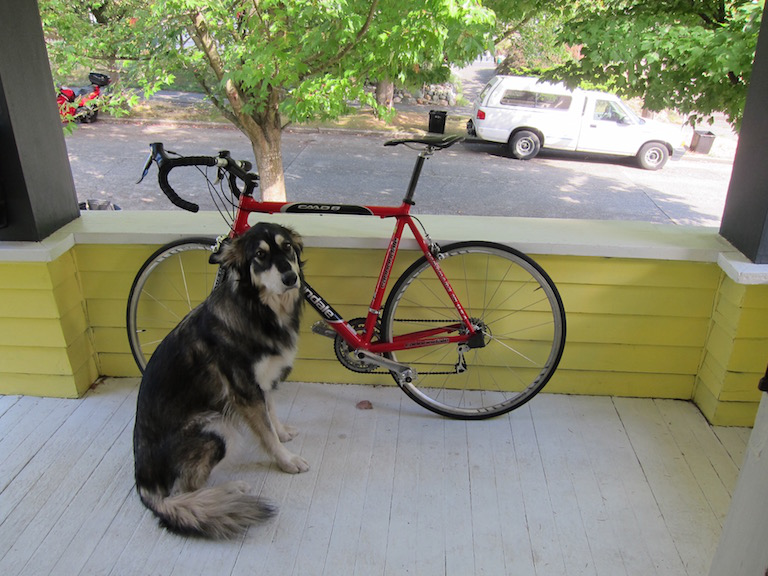

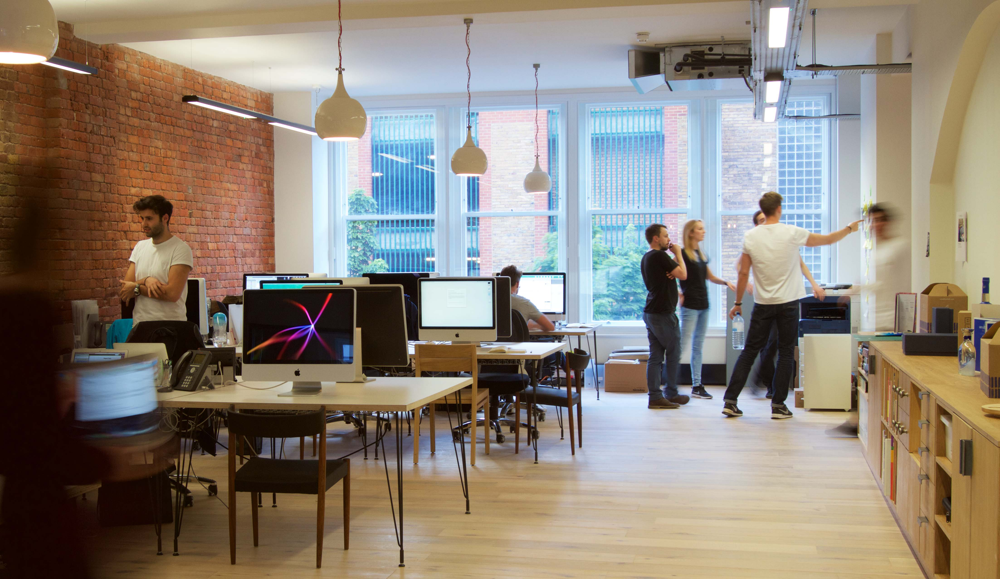

In [15]:
img_names = ['/Users/zhongyizhang/Desktop/Deep Learning & Image Recognition/DL Final Project/YOLO/dog.jpg', 
             '/Users/zhongyizhang/Desktop/Deep Learning & Image Recognition/DL Final Project/YOLO/office.jpg']
for img in img_names: display(Image.open(img))

Instructions for updating:
non-resource variables are not supported in the long term
Instructions for updating:
Use `tf.keras.layers.Conv2D` instead.
Instructions for updating:
Please use `layer.__call__` method instead.
Instructions for updating:
Use keras.layers.BatchNormalization instead.  In particular, `tf.control_dependencies(tf.GraphKeys.UPDATE_OPS)` should not be used (consult the `tf.keras.layers.batch_normalization` documentation).
Instructions for updating:
Use `tf.cast` instead.


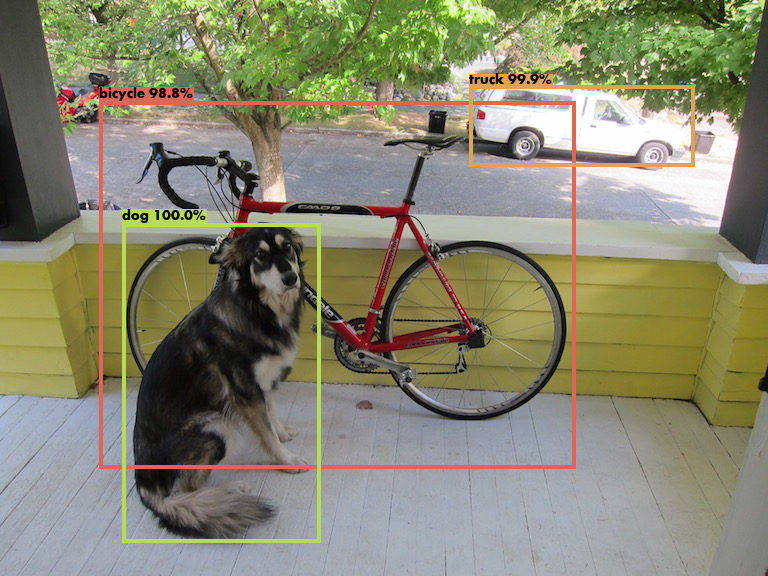

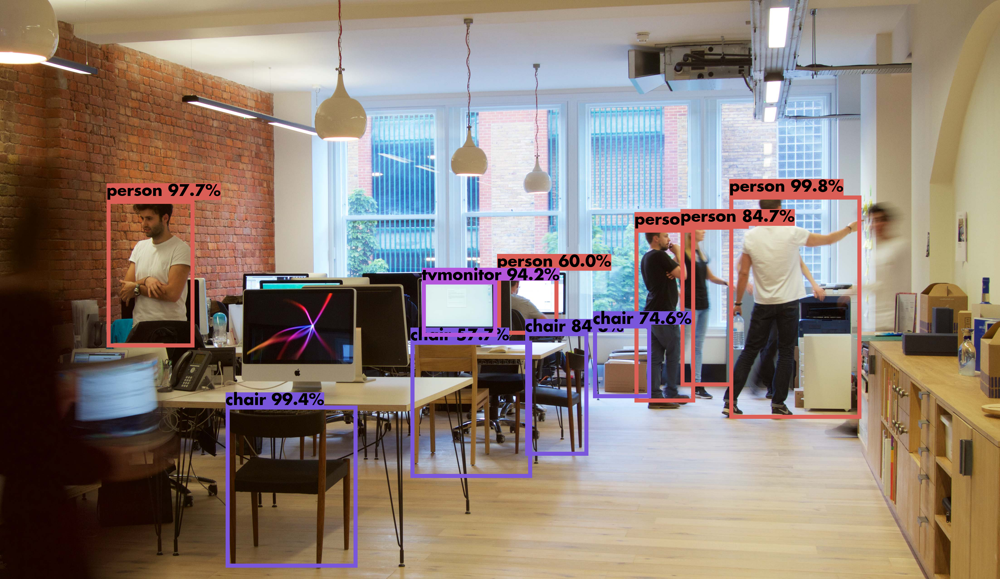

In [17]:
# https://github.com/kratzert/finetune_alexnet_with_tensorflow/issues/8
from tensorflow.python.framework import ops
# tf.reset_default_graph()

import tensorflow.compat.v1 as tf
tf.disable_v2_behavior()

batch_size = len(img_names)
batch = load_images(img_names, model_size=_MODEL_SIZE)
class_names = load_class_names('/Users/zhongyizhang/Desktop/Deep Learning & Image Recognition/DL Final Project/YOLO/coco.names')
n_classes = len(class_names)
max_output_size = 10
iou_threshold = 0.5
confidence_threshold = 0.5

model = Yolo_v3(n_classes=n_classes, model_size=_MODEL_SIZE,
                max_output_size=max_output_size,
                iou_threshold=iou_threshold,
                confidence_threshold=confidence_threshold)

inputs = tf.placeholder(tf.float32, [batch_size, 416, 416, 3])

detections = model(inputs, training=False)

model_vars = tf.global_variables(scope='yolo_v3_model')
assign_ops = load_weights(model_vars, '/Users/zhongyizhang/Desktop/Deep Learning & Image Recognition/DL Final Project/YOLO/yolov3.weights')

with tf.Session() as sess:
    sess.run(assign_ops)
    detection_result = sess.run(detections, feed_dict={inputs: batch})
    
draw_boxes(img_names, detection_result, class_names, _MODEL_SIZE)


In [21]:
# from numpy import array
img_names2 = ['/Users/zhongyizhang/Desktop/Deep Learning & Image Recognition/DL Final Project/YOLO/ZhongyiZhang.jpg',
              '/Users/zhongyizhang/Desktop/Deep Learning & Image Recognition/DL Final Project/YOLO/ZhongyiZhang_old.jpg']
# img_names2 = array(img).reshape(2, 64,64,3)
# for img in img_names2: display(Image.open(img))

In [22]:
# img_names2

In [23]:
# img1 = cv2.imread('/Users/zhongyizhang/Desktop/ZhongyiZhang.jpg')
# img1 = cv2.resize(img1, (416, 416))
# print(img1.shape)

In [24]:
# img2 = cv2.imread('/Users/zhongyizhang/Desktop/ZhongyiZhang_old.jpg')
# img2 = cv2.resize(img2, (416, 416))
# print(img2.shape)

In [25]:
# imgg = [img1, img2]

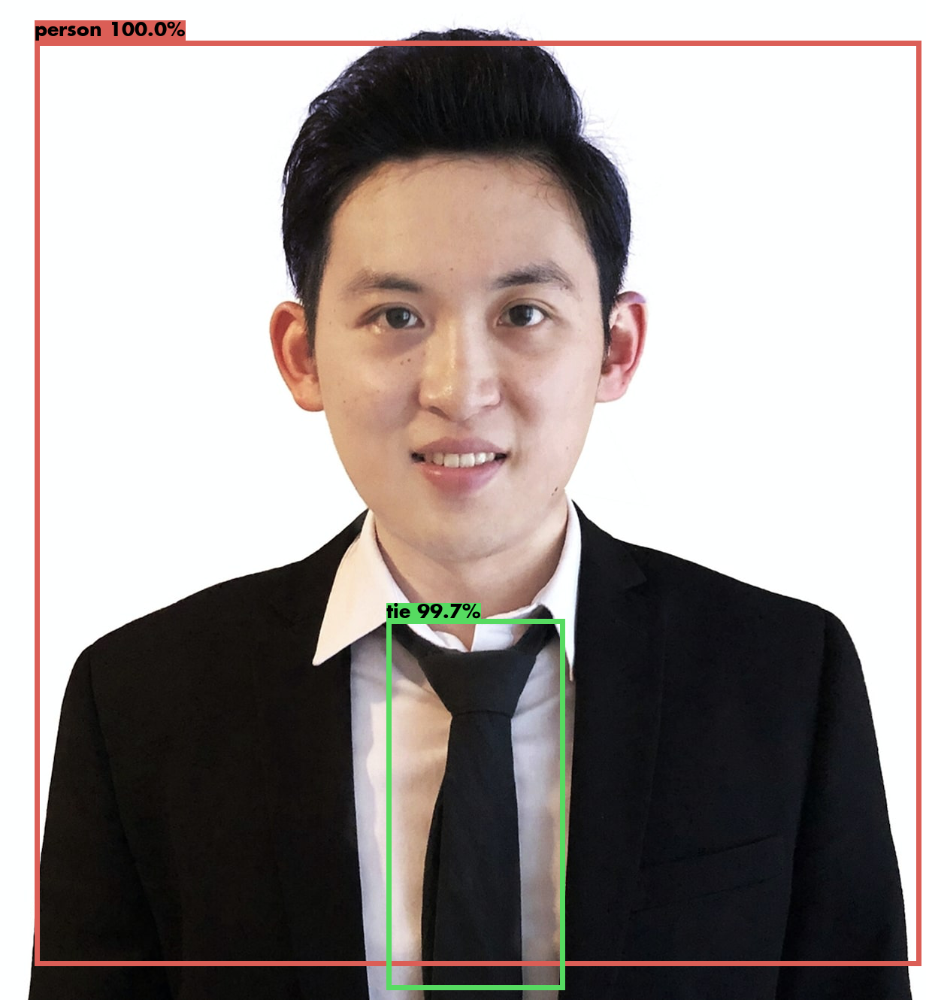

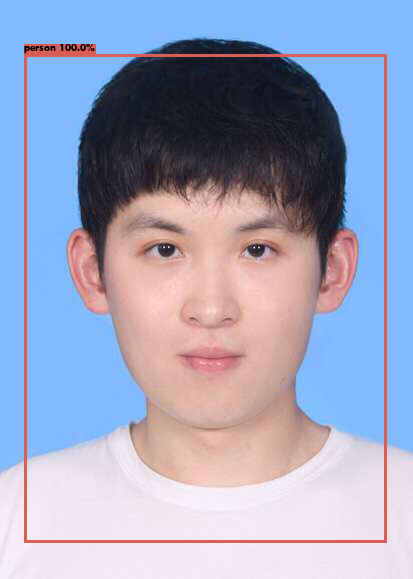

In [26]:
# https://github.com/kratzert/finetune_alexnet_with_tensorflow/issues/8
tf.reset_default_graph()
batch_size = len(img_names)
batch = load_images(img_names2, model_size=_MODEL_SIZE)
class_names = load_class_names('/Users/zhongyizhang/Desktop/Deep Learning & Image Recognition/DL Final Project/YOLO/coco.names')
n_classes = len(class_names)
max_output_size = 10
iou_threshold = 0.5
confidence_threshold = 0.5

model = Yolo_v3(n_classes=n_classes, model_size=_MODEL_SIZE,
                max_output_size=max_output_size,
                iou_threshold=iou_threshold,
                confidence_threshold=confidence_threshold)

inputs = tf.placeholder(tf.float32, [batch_size, 416, 416, 3])

detections = model(inputs, training=False)

model_vars = tf.global_variables(scope='yolo_v3_model')
assign_ops = load_weights(model_vars, '/Users/zhongyizhang/Desktop/Deep Learning & Image Recognition/DL Final Project/YOLO/yolov3.weights')

with tf.Session() as sess:
    sess.run(assign_ops)
    detection_result = sess.run(detections, feed_dict={inputs: batch})
    
draw_boxes(img_names2, detection_result, class_names, _MODEL_SIZE)


In [21]:
img3 = cv2.imread('/Users/zhongyizhang/Desktop/my_Halloween.mp4')
# img2 = cv2.resize(img2, (416, 416))
# print(img2.shape)
# ret, frame = img3.read()
# while(1):
#     ret, frame = img3.read()
#     cv2.imshow('frame',frame)
#     if cv2.waitKey(1) & 0xFF == ord('q') or ret==False :
#         img3.release()
#         cv2.destroyAllWindows()
#         break
#     cv2.imshow('frame',frame)

In [22]:
img_names3=['/Users/zhongyizhang/Desktop/DL results folder/elephantcar.jpg',
            '/Users/zhongyizhang/Desktop/DL results folder/catcar.jpg']

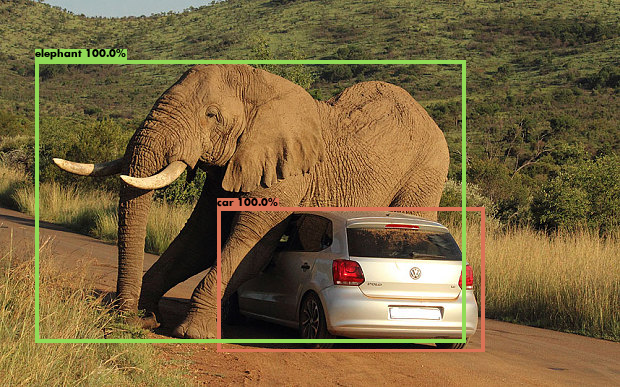

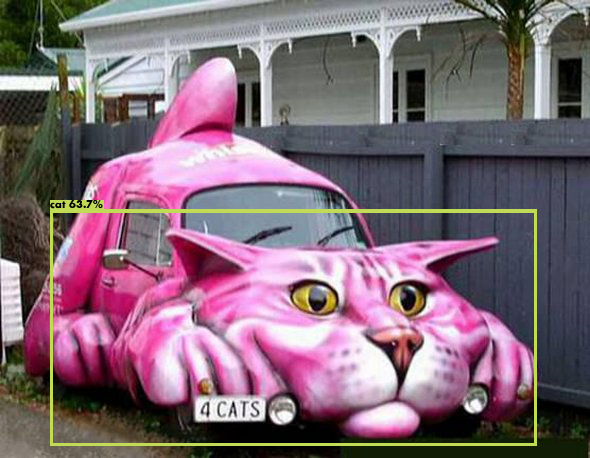

In [23]:
# https://github.com/kratzert/finetune_alexnet_with_tensorflow/issues/8
batch_size = len(img_names)
tf.reset_default_graph()
batch_size = len(img_names)
batch = load_images(img_names3, model_size=_MODEL_SIZE)
class_names = load_class_names('/Users/zhongyizhang/Desktop/Deep Learning & Image Recognition/DL Final Project/YOLO/coco.names')
n_classes = len(class_names)
max_output_size = 10
iou_threshold = 0.5
confidence_threshold = 0.5

model = Yolo_v3(n_classes=n_classes, model_size=_MODEL_SIZE,
                max_output_size=max_output_size,
                iou_threshold=iou_threshold,
                confidence_threshold=confidence_threshold)

inputs = tf.placeholder(tf.float32, [batch_size, 416, 416, 3])

detections = model(inputs, training=False)

model_vars = tf.global_variables(scope='yolo_v3_model')
assign_ops = load_weights(model_vars, '/Users/zhongyizhang/Desktop/Deep Learning & Image Recognition/DL Final Project/YOLO/yolov3.weights')

with tf.Session() as sess:
    sess.run(assign_ops)
    detection_result = sess.run(detections, feed_dict={inputs: batch})
    
draw_boxes(img_names3, detection_result, class_names, _MODEL_SIZE)


In [24]:
img_names4=['/Users/zhongyizhang/Desktop/DL results folder/dogcatcar.jpg','/Users/zhongyizhang/Desktop/DL results folder/dogcatcar2.jpg']

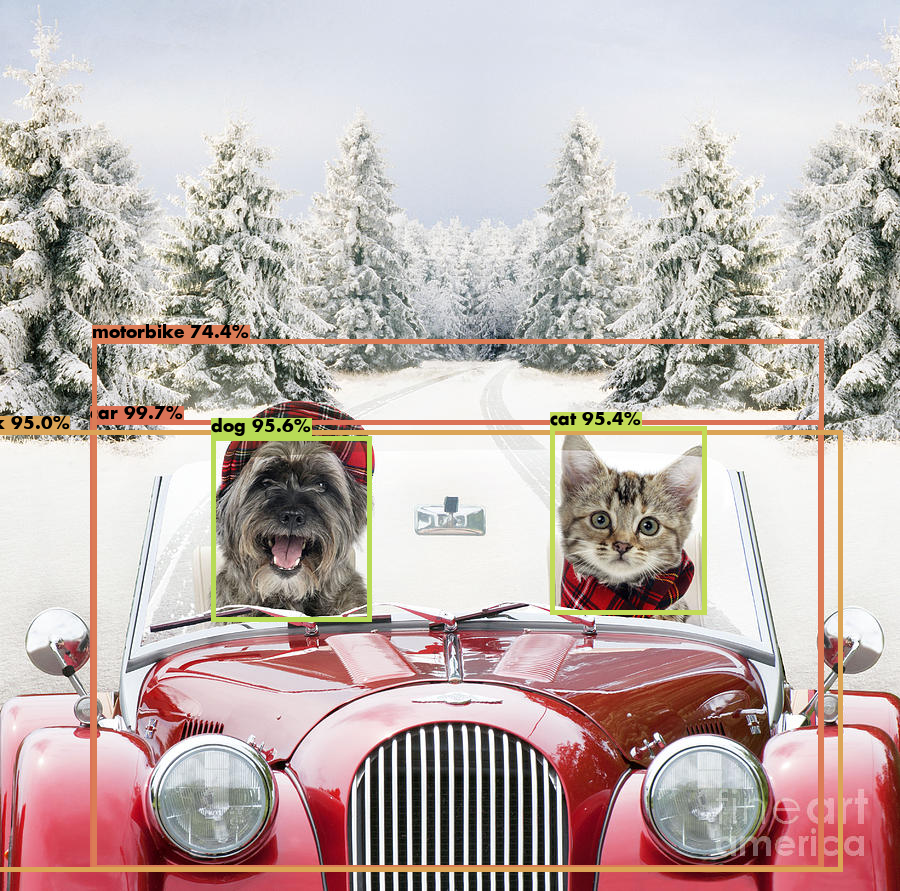

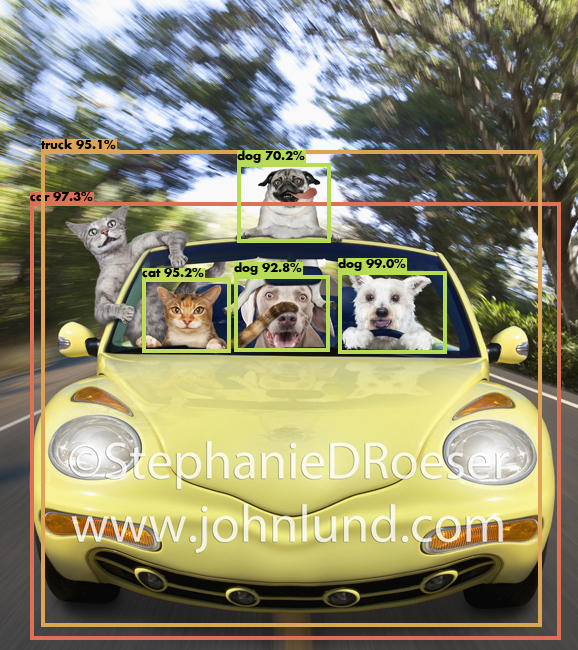

In [25]:
# https://github.com/kratzert/finetune_alexnet_with_tensorflow/issues/8
tf.reset_default_graph()
batch_size = len(img_names)
batch_size = len(img_names)
batch = load_images(img_names4, model_size=_MODEL_SIZE)
class_names = load_class_names('/Users/zhongyizhang/Desktop/Deep Learning & Image Recognition/DL Final Project/YOLO/coco.names')
n_classes = len(class_names)
max_output_size = 10
iou_threshold = 0.5
confidence_threshold = 0.5

model = Yolo_v3(n_classes=n_classes, model_size=_MODEL_SIZE,
                max_output_size=max_output_size,
                iou_threshold=iou_threshold,
                confidence_threshold=confidence_threshold)

inputs = tf.placeholder(tf.float32, [batch_size, 416, 416, 3])

detections = model(inputs, training=False)

model_vars = tf.global_variables(scope='yolo_v3_model')
assign_ops = load_weights(model_vars, '/Users/zhongyizhang/Desktop/Deep Learning & Image Recognition/DL Final Project/YOLO/yolov3.weights')

with tf.Session() as sess:
    sess.run(assign_ops)
    detection_result = sess.run(detections, feed_dict={inputs: batch})
    
draw_boxes(img_names4, detection_result, class_names, _MODEL_SIZE)


In [26]:
img_names5=['/Users/zhongyizhang/Desktop/my_Halloween.mp4','/Users/zhongyizhang/Desktop/my_Halloween2.mp4']

In [36]:
# https://github.com/kratzert/finetune_alexnet_with_tensorflow/issues/8
tf.reset_default_graph()
batch_size = len(img_names)
batch = load_images(img_names5, model_size=_MODEL_SIZE)
class_names = load_class_names('/Users/zhongyizhang/Desktop/Deep Learning & Image Recognition/DL Final Project/YOLO/coco.names')
n_classes = len(class_names)
max_output_size = 10
iou_threshold = 0.5
confidence_threshold = 0.5

model = Yolo_v3(n_classes=n_classes, model_size=_MODEL_SIZE,
                max_output_size=max_output_size,
                iou_threshold=iou_threshold,
                confidence_threshold=confidence_threshold)

inputs = tf.placeholder(tf.float32, [batch_size, 416, 416, 3])

detections = model(inputs, training=False)

model_vars = tf.global_variables(scope='yolo_v3_model')
assign_ops = load_weights(model_vars, '/Users/zhongyizhang/Desktop/Deep Learning & Image Recognition/DL Final Project/YOLO/yolov3.weights')

with tf.Session() as sess:
    sess.run(assign_ops)
    detection_result = sess.run(detections, feed_dict={inputs: batch})
    
draw_boxes(img_names5, detection_result, class_names, _MODEL_SIZE)


OSError: cannot identify image file '/Users/zhongyizhang/Desktop/my_Halloween.mp4'

In [139]:
try:
        video = cv2.VideoCapture("/Users/zhongyizhang/Desktop/my_Halloween.mp4")
except:
        print("Could not open video file")
        raise
print(video.grab())

True


In [143]:
import cv2
cap = cv2.VideoCapture('/Users/zhongyizhang/Desktop/my_Halloween.mp4')

while cap.isOpened():
    ret, frame = cap.read() # frame is ALWAYS None.
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    cv2.imshow('frame', gray)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break
cap.release()
cv2.destroyAllWindows()

error: OpenCV(4.1.1) /Users/travis/build/skvark/opencv-python/opencv/modules/imgproc/src/color.cpp:182: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'


In [152]:
from IPython.display import Video

Video("/Users/zhongyizhang/Desktop/my_Halloween2.mp4")

In [164]:
def parse_model_config(path):
    """Parses the yolo-v3 layer configuration file and returns module definitions"""
    file = open(path, 'r')
    lines = file.read().split('\n')
    lines = [x for x in lines if x and not x.startswith('#')]
    lines = [x.rstrip().lstrip() for x in lines] # get rid of fringe whitespaces
    module_defs = []
    for line in lines:
        if line.startswith('['): # This marks the start of a new block
            module_defs.append({})
            module_defs[-1]['type'] = line[1:-1].rstrip()
            if module_defs[-1]['type'] == 'convolutional':
                module_defs[-1]['batch_normalize'] = 0
        else:
            key, value = line.split("=")
            value = value.strip()
            module_defs[-1][key.rstrip()] = value.strip()

    return module_defs

def parse_data_config(path):
    """Parses the data configuration file"""
    options = dict()
    options['gpus'] = '0,1,2,3'
    options['num_workers'] = '10'
    with open(path, 'r') as fp:
        lines = fp.readlines()
    for line in lines:
        line = line.strip()
        if line == '' or line.startswith('#'):
            continue
        key, value = line.split('=')
        options[key.strip()] = value.strip()
    return options

In [165]:
# !pip install torch
# !pip install utils
from __future__ import division
import math
import time
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable
import numpy as np

#import matplotlib.pyplot as plt
#import matplotlib.patches as patches


def load_classes(path):
    """
    Loads class labels at 'path'
    """
    fp = open(path, "r")
    names = fp.read().split("\n")[:-1]
    return names


def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find("BatchNorm2d") != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)


def compute_ap(recall, precision):
    """ Compute the average precision, given the recall and precision curves.
    Code originally from https://github.com/rbgirshick/py-faster-rcnn.
    # Arguments
        recall:    The recall curve (list).
        precision: The precision curve (list).
    # Returns
        The average precision as computed in py-faster-rcnn.
    """
    # correct AP calculation
    # first append sentinel values at the end
    mrec = np.concatenate(([0.0], recall, [1.0]))
    mpre = np.concatenate(([0.0], precision, [0.0]))

    # compute the precision envelope
    for i in range(mpre.size - 1, 0, -1):
        mpre[i - 1] = np.maximum(mpre[i - 1], mpre[i])

    # to calculate area under PR curve, look for points
    # where X axis (recall) changes value
    i = np.where(mrec[1:] != mrec[:-1])[0]

    # and sum (\Delta recall) * prec
    ap = np.sum((mrec[i + 1] - mrec[i]) * mpre[i + 1])
    return ap


def bbox_iou(box1, box2, x1y1x2y2=True):
    """
    Returns the IoU of two bounding boxes
    """
    if not x1y1x2y2:
        # Transform from center and width to exact coordinates
        b1_x1, b1_x2 = box1[:, 0] - box1[:, 2] / 2, box1[:, 0] + box1[:, 2] / 2
        b1_y1, b1_y2 = box1[:, 1] - box1[:, 3] / 2, box1[:, 1] + box1[:, 3] / 2
        b2_x1, b2_x2 = box2[:, 0] - box2[:, 2] / 2, box2[:, 0] + box2[:, 2] / 2
        b2_y1, b2_y2 = box2[:, 1] - box2[:, 3] / 2, box2[:, 1] + box2[:, 3] / 2
    else:
        # Get the coordinates of bounding boxes
        b1_x1, b1_y1, b1_x2, b1_y2 = box1[:, 0], box1[:, 1], box1[:, 2], box1[:, 3]
        b2_x1, b2_y1, b2_x2, b2_y2 = box2[:, 0], box2[:, 1], box2[:, 2], box2[:, 3]

    # get the corrdinates of the intersection rectangle
    inter_rect_x1 = torch.max(b1_x1, b2_x1)
    inter_rect_y1 = torch.max(b1_y1, b2_y1)
    inter_rect_x2 = torch.min(b1_x2, b2_x2)
    inter_rect_y2 = torch.min(b1_y2, b2_y2)
    # Intersection area
    inter_area = torch.clamp(inter_rect_x2 - inter_rect_x1 + 1, min=0) * torch.clamp(
        inter_rect_y2 - inter_rect_y1 + 1, min=0
    )
    # Union Area
    b1_area = (b1_x2 - b1_x1 + 1) * (b1_y2 - b1_y1 + 1)
    b2_area = (b2_x2 - b2_x1 + 1) * (b2_y2 - b2_y1 + 1)

    iou = inter_area / (b1_area + b2_area - inter_area + 1e-16)

    return iou


def bbox_iou_numpy(box1, box2):
    """Computes IoU between bounding boxes.
    Parameters
    ----------
    box1 : ndarray
        (N, 4) shaped array with bboxes
    box2 : ndarray
        (M, 4) shaped array with bboxes
    Returns
    -------
    : ndarray
        (N, M) shaped array with IoUs
    """
    area = (box2[:, 2] - box2[:, 0]) * (box2[:, 3] - box2[:, 1])

    iw = np.minimum(np.expand_dims(box1[:, 2], axis=1), box2[:, 2]) - np.maximum(
        np.expand_dims(box1[:, 0], 1), box2[:, 0]
    )
    ih = np.minimum(np.expand_dims(box1[:, 3], axis=1), box2[:, 3]) - np.maximum(
        np.expand_dims(box1[:, 1], 1), box2[:, 1]
    )

    iw = np.maximum(iw, 0)
    ih = np.maximum(ih, 0)

    ua = np.expand_dims((box1[:, 2] - box1[:, 0]) * (box1[:, 3] - box1[:, 1]), axis=1) + area - iw * ih

    ua = np.maximum(ua, np.finfo(float).eps)

    intersection = iw * ih

    return intersection / ua


def non_max_suppression(prediction, num_classes, conf_thres=0.5, nms_thres=0.4):
    """
    Removes detections with lower object confidence score than 'conf_thres' and performs
    Non-Maximum Suppression to further filter detections.
    Returns detections with shape:
        (x1, y1, x2, y2, object_conf, class_score, class_pred)
    """

    # From (center x, center y, width, height) to (x1, y1, x2, y2)
    box_corner = prediction.new(prediction.shape)
    box_corner[:, :, 0] = prediction[:, :, 0] - prediction[:, :, 2] / 2
    box_corner[:, :, 1] = prediction[:, :, 1] - prediction[:, :, 3] / 2
    box_corner[:, :, 2] = prediction[:, :, 0] + prediction[:, :, 2] / 2
    box_corner[:, :, 3] = prediction[:, :, 1] + prediction[:, :, 3] / 2
    prediction[:, :, :4] = box_corner[:, :, :4]

    output = [None for _ in range(len(prediction))]
    for image_i, image_pred in enumerate(prediction):
        # Filter out confidence scores below threshold
        conf_mask = (image_pred[:, 4] >= conf_thres).squeeze()
        image_pred = image_pred[conf_mask]
        # If none are remaining => process next image
        if not image_pred.size(0):
            continue
        # Get score and class with highest confidence
        class_conf, class_pred = torch.max(image_pred[:, 5 : 5 + num_classes], 1, keepdim=True)
        # Detections ordered as (x1, y1, x2, y2, obj_conf, class_conf, class_pred)
        detections = torch.cat((image_pred[:, :5], class_conf.float(), class_pred.float()), 1)
        # Iterate through all predicted classes
        unique_labels = detections[:, -1].cpu().unique()
        if prediction.is_cuda:
            unique_labels = unique_labels.cuda()
        for c in unique_labels:
            # Get the detections with the particular class
            detections_class = detections[detections[:, -1] == c]
            # Sort the detections by maximum objectness confidence
            _, conf_sort_index = torch.sort(detections_class[:, 4], descending=True)
            detections_class = detections_class[conf_sort_index]
            # Perform non-maximum suppression
            max_detections = []
            while detections_class.size(0):
                # Get detection with highest confidence and save as max detection
                max_detections.append(detections_class[0].unsqueeze(0))
                # Stop if we're at the last detection
                if len(detections_class) == 1:
                    break
                # Get the IOUs for all boxes with lower confidence
                ious = bbox_iou(max_detections[-1], detections_class[1:])
                # Remove detections with IoU >= NMS threshold
                detections_class = detections_class[1:][ious < nms_thres]

            max_detections = torch.cat(max_detections).data
            # Add max detections to outputs
            output[image_i] = (
                max_detections if output[image_i] is None else torch.cat((output[image_i], max_detections))
            )

    return output


def build_targets(
    pred_boxes, pred_conf, pred_cls, target, anchors, num_anchors, num_classes, grid_size, ignore_thres, img_dim
):
    nB = target.size(0)
    nA = num_anchors
    nC = num_classes
    nG = grid_size
    mask = torch.zeros(nB, nA, nG, nG)
    conf_mask = torch.ones(nB, nA, nG, nG)
    tx = torch.zeros(nB, nA, nG, nG)
    ty = torch.zeros(nB, nA, nG, nG)
    tw = torch.zeros(nB, nA, nG, nG)
    th = torch.zeros(nB, nA, nG, nG)
    tconf = torch.ByteTensor(nB, nA, nG, nG).fill_(0)
    tcls = torch.ByteTensor(nB, nA, nG, nG, nC).fill_(0)

    nGT = 0
    nCorrect = 0
    for b in range(nB):
        for t in range(target.shape[1]):
            if target[b, t].sum() == 0:
                continue
            nGT += 1
            # Convert to position relative to box
            gx = target[b, t, 1] * nG
            gy = target[b, t, 2] * nG
            gw = target[b, t, 3] * nG
            gh = target[b, t, 4] * nG
            # Get grid box indices
            gi = int(gx)
            gj = int(gy)
            # Get shape of gt box
            gt_box = torch.FloatTensor(np.array([0, 0, gw, gh])).unsqueeze(0)
            # Get shape of anchor box
            anchor_shapes = torch.FloatTensor(np.concatenate((np.zeros((len(anchors), 2)), np.array(anchors)), 1))
            # Calculate iou between gt and anchor shapes
            anch_ious = bbox_iou(gt_box, anchor_shapes)
            # Where the overlap is larger than threshold set mask to zero (ignore)
            conf_mask[b, anch_ious > ignore_thres, gj, gi] = 0
            # Find the best matching anchor box
            best_n = np.argmax(anch_ious)
            # Get ground truth box
            gt_box = torch.FloatTensor(np.array([gx, gy, gw, gh])).unsqueeze(0)
            # Get the best prediction
            pred_box = pred_boxes[b, best_n, gj, gi].unsqueeze(0)
            # Masks
            mask[b, best_n, gj, gi] = 1
            conf_mask[b, best_n, gj, gi] = 1
            # Coordinates
            tx[b, best_n, gj, gi] = gx - gi
            ty[b, best_n, gj, gi] = gy - gj
            # Width and height
            tw[b, best_n, gj, gi] = math.log(gw / anchors[best_n][0] + 1e-16)
            th[b, best_n, gj, gi] = math.log(gh / anchors[best_n][1] + 1e-16)
            # One-hot encoding of label
            target_label = int(target[b, t, 0])
            tcls[b, best_n, gj, gi, target_label] = 1
            tconf[b, best_n, gj, gi] = 1

            # Calculate iou between ground truth and best matching prediction
            iou = bbox_iou(gt_box, pred_box, x1y1x2y2=False)
            pred_label = torch.argmax(pred_cls[b, best_n, gj, gi])
            score = pred_conf[b, best_n, gj, gi]
            if iou > 0.5 and pred_label == target_label and score > 0.5:
                nCorrect += 1

    return nGT, nCorrect, mask, conf_mask, tx, ty, tw, th, tconf, tcls


def to_categorical(y, num_classes):
    """ 1-hot encodes a tensor """
    return torch.from_numpy(np.eye(num_classes, dtype="uint8")[y])

In [1]:
from __future__ import division

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable
import numpy as np

from PIL import Image

from utils.parse_config import *
from utils.utils import build_targets
from collections import defaultdict

##import matplotlib.pyplot as plt
##import matplotlib.patches as patches


def create_modules(module_defs):
    """
    Constructs module list of layer blocks from module configuration in module_defs
    """
    hyperparams = module_defs.pop(0)
    output_filters = [int(hyperparams["channels"])]
    module_list = nn.ModuleList()
    for i, module_def in enumerate(module_defs):
        modules = nn.Sequential()

        if module_def["type"] == "convolutional":
            bn = int(module_def["batch_normalize"])
            filters = int(module_def["filters"])
            kernel_size = int(module_def["size"])
            pad = (kernel_size - 1) // 2 if int(module_def["pad"]) else 0
            modules.add_module(
                "conv_%d" % i,
                nn.Conv2d(
                    in_channels=output_filters[-1],
                    out_channels=filters,
                    kernel_size=kernel_size,
                    stride=int(module_def["stride"]),
                    padding=pad,
                    bias=not bn,
                ),
            )
            if bn:
                modules.add_module("batch_norm_%d" % i, nn.BatchNorm2d(filters))
            if module_def["activation"] == "leaky":
                modules.add_module("leaky_%d" % i, nn.LeakyReLU(0.1))

        elif module_def["type"] == "maxpool":
            kernel_size = int(module_def["size"])
            stride = int(module_def["stride"])
            if kernel_size == 2 and stride == 1:
                padding = nn.ZeroPad2d((0, 1, 0, 1))
                modules.add_module("_debug_padding_%d" % i, padding)
            maxpool = nn.MaxPool2d(
                kernel_size=int(module_def["size"]),
                stride=int(module_def["stride"]),
                padding=int((kernel_size - 1) // 2),
            )
            modules.add_module("maxpool_%d" % i, maxpool)

        elif module_def["type"] == "upsample":
            upsample = nn.Upsample(scale_factor=int(module_def["stride"]), mode="nearest")
            modules.add_module("upsample_%d" % i, upsample)

        elif module_def["type"] == "route":
            layers = [int(x) for x in module_def["layers"].split(",")]
            filters = sum([output_filters[layer_i] for layer_i in layers])
            modules.add_module("route_%d" % i, EmptyLayer())

        elif module_def["type"] == "shortcut":
            filters = output_filters[int(module_def["from"])]
            modules.add_module("shortcut_%d" % i, EmptyLayer())

        elif module_def["type"] == "yolo":
            anchor_idxs = [int(x) for x in module_def["mask"].split(",")]
            # Extract anchors
            anchors = [int(x) for x in module_def["anchors"].split(",")]
            anchors = [(anchors[i], anchors[i + 1]) for i in range(0, len(anchors), 2)]
            anchors = [anchors[i] for i in anchor_idxs]
            num_classes = int(module_def["classes"])
            img_height = int(hyperparams["height"])
            # Define detection layer
            yolo_layer = YOLOLayer(anchors, num_classes, img_height)
            modules.add_module("yolo_%d" % i, yolo_layer)
        # Register module list and number of output filters
        module_list.append(modules)
        output_filters.append(filters)

    return hyperparams, module_list


class EmptyLayer(nn.Module):
    """Placeholder for 'route' and 'shortcut' layers"""

    def __init__(self):
        super(EmptyLayer, self).__init__()


class YOLOLayer(nn.Module):
    """Detection layer"""

    def __init__(self, anchors, num_classes, img_dim):
        super(YOLOLayer, self).__init__()
        self.anchors = anchors
        self.num_anchors = len(anchors)
        self.num_classes = num_classes
        self.bbox_attrs = 5 + num_classes
        self.image_dim = img_dim
        self.ignore_thres = 0.5
        self.lambda_coord = 1

        self.mse_loss = nn.MSELoss(size_average=True)  # Coordinate loss
        self.bce_loss = nn.BCELoss(size_average=True)  # Confidence loss
        self.ce_loss = nn.CrossEntropyLoss()  # Class loss

    def forward(self, x, targets=None):
        nA = self.num_anchors
        nB = x.size(0)
        nG = x.size(2)
        stride = self.image_dim / nG

        # Tensors for cuda support
        FloatTensor = torch.cuda.FloatTensor if x.is_cuda else torch.FloatTensor
        LongTensor = torch.cuda.LongTensor if x.is_cuda else torch.LongTensor
        ByteTensor = torch.cuda.ByteTensor if x.is_cuda else torch.ByteTensor

        prediction = x.view(nB, nA, self.bbox_attrs, nG, nG).permute(0, 1, 3, 4, 2).contiguous()

        # Get outputs
        x = torch.sigmoid(prediction[..., 0])  # Center x
        y = torch.sigmoid(prediction[..., 1])  # Center y
        w = prediction[..., 2]  # Width
        h = prediction[..., 3]  # Height
        pred_conf = torch.sigmoid(prediction[..., 4])  # Conf
        pred_cls = torch.sigmoid(prediction[..., 5:])  # Cls pred.

        # Calculate offsets for each grid
        grid_x = torch.arange(nG).repeat(nG, 1).view([1, 1, nG, nG]).type(FloatTensor)
        grid_y = torch.arange(nG).repeat(nG, 1).t().view([1, 1, nG, nG]).type(FloatTensor)
        scaled_anchors = FloatTensor([(a_w / stride, a_h / stride) for a_w, a_h in self.anchors])
        anchor_w = scaled_anchors[:, 0:1].view((1, nA, 1, 1))
        anchor_h = scaled_anchors[:, 1:2].view((1, nA, 1, 1))

        # Add offset and scale with anchors
        pred_boxes = FloatTensor(prediction[..., :4].shape)
        pred_boxes[..., 0] = x.data + grid_x
        pred_boxes[..., 1] = y.data + grid_y
        pred_boxes[..., 2] = torch.exp(w.data) * anchor_w
        pred_boxes[..., 3] = torch.exp(h.data) * anchor_h

        # Training
        if targets is not None:

            if x.is_cuda:
                self.mse_loss = self.mse_loss.cuda()
                self.bce_loss = self.bce_loss.cuda()
                self.ce_loss = self.ce_loss.cuda()

            nGT, nCorrect, mask, conf_mask, tx, ty, tw, th, tconf, tcls = build_targets(
                pred_boxes=pred_boxes.cpu().data,
                pred_conf=pred_conf.cpu().data,
                pred_cls=pred_cls.cpu().data,
                target=targets.cpu().data,
                anchors=scaled_anchors.cpu().data,
                num_anchors=nA,
                num_classes=self.num_classes,
                grid_size=nG,
                ignore_thres=self.ignore_thres,
                img_dim=self.image_dim,
            )

            nProposals = int((pred_conf > 0.5).sum().item())
            recall = float(nCorrect / nGT) if nGT else 1
            precision = float(nCorrect / nProposals)

            # Handle masks
            mask = Variable(mask.type(ByteTensor))
            conf_mask = Variable(conf_mask.type(ByteTensor))

            # Handle target variables
            tx = Variable(tx.type(FloatTensor), requires_grad=False)
            ty = Variable(ty.type(FloatTensor), requires_grad=False)
            tw = Variable(tw.type(FloatTensor), requires_grad=False)
            th = Variable(th.type(FloatTensor), requires_grad=False)
            tconf = Variable(tconf.type(FloatTensor), requires_grad=False)
            tcls = Variable(tcls.type(LongTensor), requires_grad=False)

            # Get conf mask where gt and where there is no gt
            conf_mask_true = mask
            conf_mask_false = conf_mask - mask

            # Mask outputs to ignore non-existing objects
            loss_x = self.mse_loss(x[mask], tx[mask])
            loss_y = self.mse_loss(y[mask], ty[mask])
            loss_w = self.mse_loss(w[mask], tw[mask])
            loss_h = self.mse_loss(h[mask], th[mask])
            loss_conf = self.bce_loss(pred_conf[conf_mask_false], tconf[conf_mask_false]) + self.bce_loss(
                pred_conf[conf_mask_true], tconf[conf_mask_true]
            )
            loss_cls = (1 / nB) * self.ce_loss(pred_cls[mask], torch.argmax(tcls[mask], 1))
            loss = loss_x + loss_y + loss_w + loss_h + loss_conf + loss_cls

            return (
                loss,
                loss_x.item(),
                loss_y.item(),
                loss_w.item(),
                loss_h.item(),
                loss_conf.item(),
                loss_cls.item(),
                recall,
                precision,
            )

        else:
            # If not in training phase return predictions
            output = torch.cat(
                (
                    pred_boxes.view(nB, -1, 4) * stride,
                    pred_conf.view(nB, -1, 1),
                    pred_cls.view(nB, -1, self.num_classes),
                ),
                -1,
            )
            return output


class Darknet(nn.Module):
    """YOLOv3 object detection model"""

    def __init__(self, config_path, img_size=416):
        super(Darknet, self).__init__()
        self.module_defs = parse_model_config(config_path)
        self.hyperparams, self.module_list = create_modules(self.module_defs)
        self.img_size = img_size
        self.seen = 0
        self.header_info = np.array([0, 0, 0, self.seen, 0])
        self.loss_names = ["x", "y", "w", "h", "conf", "cls", "recall", "precision"]

    def forward(self, x, targets=None):
        is_training = targets is not None
        output = []
        self.losses = defaultdict(float)
        layer_outputs = []
        for i, (module_def, module) in enumerate(zip(self.module_defs, self.module_list)):
            if module_def["type"] in ["convolutional", "upsample", "maxpool"]:
                x = module(x)
            elif module_def["type"] == "route":
                layer_i = [int(x) for x in module_def["layers"].split(",")]
                x = torch.cat([layer_outputs[i] for i in layer_i], 1)
            elif module_def["type"] == "shortcut":
                layer_i = int(module_def["from"])
                x = layer_outputs[-1] + layer_outputs[layer_i]
            elif module_def["type"] == "yolo":
                # Train phase: get loss
                if is_training:
                    x, *losses = module[0](x, targets)
                    for name, loss in zip(self.loss_names, losses):
                        self.losses[name] += loss
                # Test phase: Get detections
                else:
                    x = module(x)
                output.append(x)
            layer_outputs.append(x)

        self.losses["recall"] /= 3
        self.losses["precision"] /= 3
        return sum(output) if is_training else torch.cat(output, 1)

    def load_weights(self, weights_path):
        """Parses and loads the weights stored in 'weights_path'"""

        # Open the weights file
        fp = open(weights_path, "rb")
        header = np.fromfile(fp, dtype=np.int32, count=5)  # First five are header values

        # Needed to write header when saving weights
        self.header_info = header

        self.seen = header[3]
        weights = np.fromfile(fp, dtype=np.float32)  # The rest are weights
        fp.close()

        ptr = 0
        for i, (module_def, module) in enumerate(zip(self.module_defs, self.module_list)):
            if module_def["type"] == "convolutional":
                conv_layer = module[0]
                if module_def["batch_normalize"]:
                    # Load BN bias, weights, running mean and running variance
                    bn_layer = module[1]
                    num_b = bn_layer.bias.numel()  # Number of biases
                    # Bias
                    bn_b = torch.from_numpy(weights[ptr : ptr + num_b]).view_as(bn_layer.bias)
                    bn_layer.bias.data.copy_(bn_b)
                    ptr += num_b
                    # Weight
                    bn_w = torch.from_numpy(weights[ptr : ptr + num_b]).view_as(bn_layer.weight)
                    bn_layer.weight.data.copy_(bn_w)
                    ptr += num_b
                    # Running Mean
                    bn_rm = torch.from_numpy(weights[ptr : ptr + num_b]).view_as(bn_layer.running_mean)
                    bn_layer.running_mean.data.copy_(bn_rm)
                    ptr += num_b
                    # Running Var
                    bn_rv = torch.from_numpy(weights[ptr : ptr + num_b]).view_as(bn_layer.running_var)
                    bn_layer.running_var.data.copy_(bn_rv)
                    ptr += num_b
                else:
                    # Load conv. bias
                    num_b = conv_layer.bias.numel()
                    conv_b = torch.from_numpy(weights[ptr : ptr + num_b]).view_as(conv_layer.bias)
                    conv_layer.bias.data.copy_(conv_b)
                    ptr += num_b
                # Load conv. weights
                num_w = conv_layer.weight.numel()
                conv_w = torch.from_numpy(weights[ptr : ptr + num_w]).view_as(conv_layer.weight)
                conv_layer.weight.data.copy_(conv_w)
                ptr += num_w

    """
        @:param path    - path of the new weights file
        @:param cutoff  - save layers between 0 and cutoff (cutoff = -1 -> all are saved)
    """

    def save_weights(self, path, cutoff=-1):

        fp = open(path, "wb")
        self.header_info[3] = self.seen
        self.header_info.tofile(fp)

        # Iterate through layers
        for i, (module_def, module) in enumerate(zip(self.module_defs[:cutoff], self.module_list[:cutoff])):
            if module_def["type"] == "convolutional":
                conv_layer = module[0]
                # If batch norm, load bn first
                if module_def["batch_normalize"]:
                    bn_layer = module[1]
                    bn_layer.bias.data.cpu().numpy().tofile(fp)
                    bn_layer.weight.data.cpu().numpy().tofile(fp)
                    bn_layer.running_mean.data.cpu().numpy().tofile(fp)
                    bn_layer.running_var.data.cpu().numpy().tofile(fp)
                # Load conv bias
                else:
                    conv_layer.bias.data.cpu().numpy().tofile(fp)
                # Load conv weights
                conv_layer.weight.data.cpu().numpy().tofile(fp)

        fp.close()

ModuleNotFoundError: No module named 'utils.parse_config'

In [170]:
from models import *
from utils import *
import os, sys, time, datetime, random
import torch
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
from torch.autograd import Variable
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

ModuleNotFoundError: No module named 'models'

In [149]:
videopath = '/Users/zhongyizhang/Desktop/my_Halloween2.mp4'
%pylab inline 
import cv2
from IPython.display import clear_output
cmap = plt.get_cmap('tab20b')
colors = [cmap(i)[:3] for i in np.linspace(0, 1, 20)]
# initialize Sort object and video capture
from sort import *
vid = cv2.VideoCapture(videopath)
mot_tracker = Sort()
#while(True):
for ii in range(40):
    ret, frame = vid.read()
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    pilimg = Image.fromarray(frame)
    detections = detect_image(pilimg)
    img = np.array(pilimg)
    pad_x = max(img.shape[0] - img.shape[1], 0) * (img_size / max(img.shape))
    pad_y = max(img.shape[1] - img.shape[0], 0) * (img_size / max(img.shape))
    unpad_h = img_size - pad_y
    unpad_w = img_size - pad_x
    if detections is not None:
        tracked_objects = mot_tracker.update(detections.cpu())
        unique_labels = detections[:, -1].cpu().unique()
        n_cls_preds = len(unique_labels)
        for x1, y1, x2, y2, obj_id, cls_pred in tracked_objects:
            box_h = int(((y2 - y1) / unpad_h) * img.shape[0])
            box_w = int(((x2 - x1) / unpad_w) * img.shape[1])
            y1 = int(((y1 - pad_y // 2) / unpad_h) * img.shape[0])
            x1 = int(((x1 - pad_x // 2) / unpad_w) * img.shape[1])
            color = colors[int(obj_id) % len(colors)]
            color = [i * 255 for i in color]
            cls = classes[int(cls_pred)]
            cv2.rectangle(frame, (x1, y1), (x1+box_w, y1+box_h),
                         color, 4)
            cv2.rectangle(frame, (x1, y1-35), (x1+len(cls)*19+60,
                         y1), color, -1)
            cv2.putText(frame, cls + "-" + str(int(obj_id)), 
                        (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 
                        1, (255,255,255), 3)
    fig=figure(figsize=(12, 8))
    title("Video Stream")
    imshow(frame)
    show()
    clear_output(wait=True)

Populating the interactive namespace from numpy and matplotlib


/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/IPython/core/magics/pylab.py:160: UserWarning: pylab import has clobbered these variables: ['random', 'gray']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


ModuleNotFoundError: No module named 'sort'